# 3D Gaussian Mask Generation Notebook

In [25]:
import sys
sys.dont_write_bytecode = True

import torch 
import numpy as np 
from matplotlib import pyplot as plt
from plyfile import PlyData
from projection.projections import camera_to_image, world_to_camera, filter_pixel_points, get_3D_indices
from util.view import Viewset

### Constants

In [26]:
# Path to 3D ply scene made from Gaussian Splatting 
GAUSSIAN_FILE = './projection/point_cloud/iteration_30000/point_cloud.ply' 

# Path to output of Segmented Gaussian File (Will be generated by this notebook) 
OUTPUT_FILE = './outputs/multiview_kmeans_100.ply' 

# Path to cameras.json file
CAMERAS_JSON = './projection/cameras.json' 

# Path to multiview images folder
IMAGE_PATH = './dataset/truck/images/'

# sampling radius for mapping 2D prompts to 3D gaussians
EPS = 10

MASK_PADDING = 10 # do not sample initial points from within padding

### Input variables

In [27]:
init_view_count = 4 # randomly sample some views to generate initial prompt points from

prompts_per_view = 2
 
text_prompt = "truck"

# init_view_index = 125

# init_prompts = torch.tensor([[380, 250], [800, 260], [200, 250], [200, 350]]).T

# create masks from a random subset of views if rate < 1
view_sampling_rate = 0.5

***
# 1. Initialization

### Load Gaussians

In [28]:
pcd = PlyData.read(GAUSSIAN_FILE)['vertex']
pcd_array = np.array([pcd['x'], pcd['y'], pcd['z']], dtype=np.double).T
opacities = pcd['opacity']

pcd_array = torch.from_numpy(pcd_array)
opacities = torch.from_numpy(opacities)

In [5]:
# load sam and lang_sam
from sam.sam import SAM
from sam.lang_sam import LangSAM

torch.cuda.empty_cache()

sam = SAM("./sam/sam_vit_h_4b8939.pth")
langsam = LangSAM(sam.predictor)

Loading pth...DONE


C:\Users\HP\AppData\Roaming\Python\Python311\site-packages\torch\functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ..\aten\src\ATen\native\TensorShape.cpp:3527.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


final text_encoder_type: bert-base-uncased
Model loaded from C:\Users\HP\.cache\huggingface\hub\models--ShilongLiu--GroundingDINO\snapshots\a94c9b567a2a374598f05c584e96798a170c56fb\groundingdino_swinb_cogcoor.pth 
 => _IncompatibleKeys(missing_keys=[], unexpected_keys=['label_enc.weight', 'bert.embeddings.position_ids'])


### Load views, select initial views, and 2D prompts

c:\Python311\Lib\site-packages\transformers\modeling_utils.py:907: FutureWarning: The `device` argument is deprecated and will be removed in v5 of Transformers.
  warnings.warn(
C:\Users\HP\AppData\Roaming\Python\Python311\site-packages\torch\utils\checkpoint.py:429: UserWarning: torch.utils.checkpoint: please pass in use_reentrant=True or use_reentrant=False explicitly. The default value of use_reentrant will be updated to be False in the future. To maintain current behavior, pass use_reentrant=True. It is recommended that you use use_reentrant=False. Refer to docs for more details on the differences between the two variants.
  warnings.warn(
C:\Users\HP\AppData\Roaming\Python\Python311\site-packages\torch\utils\checkpoint.py:61: UserWarning: None of the inputs have requires_grad=True. Gradients will be None
  warnings.warn(


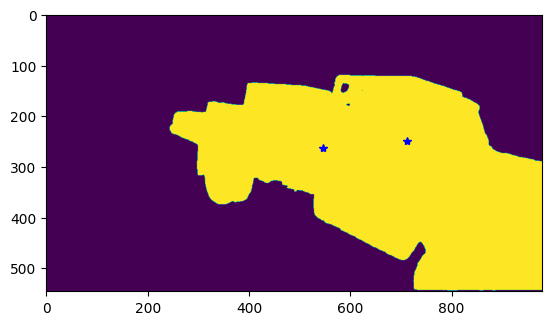

c:\Python311\Lib\site-packages\transformers\modeling_utils.py:907: FutureWarning: The `device` argument is deprecated and will be removed in v5 of Transformers.
  warnings.warn(
C:\Users\HP\AppData\Roaming\Python\Python311\site-packages\torch\utils\checkpoint.py:429: UserWarning: torch.utils.checkpoint: please pass in use_reentrant=True or use_reentrant=False explicitly. The default value of use_reentrant will be updated to be False in the future. To maintain current behavior, pass use_reentrant=True. It is recommended that you use use_reentrant=False. Refer to docs for more details on the differences between the two variants.
  warnings.warn(
C:\Users\HP\AppData\Roaming\Python\Python311\site-packages\torch\utils\checkpoint.py:61: UserWarning: None of the inputs have requires_grad=True. Gradients will be None
  warnings.warn(


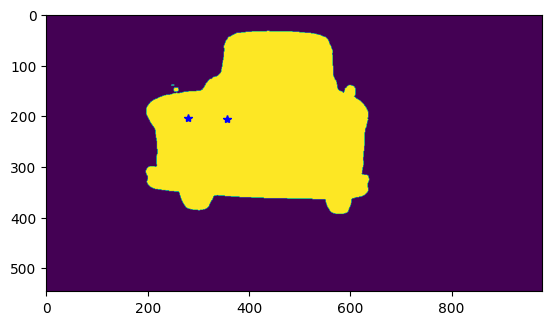

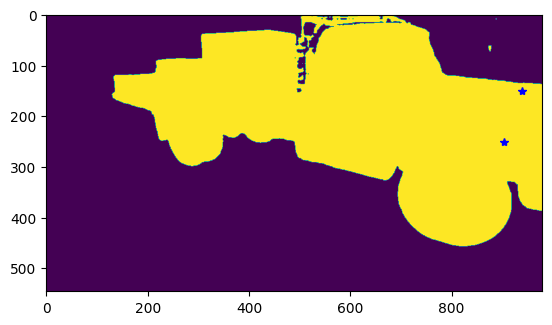

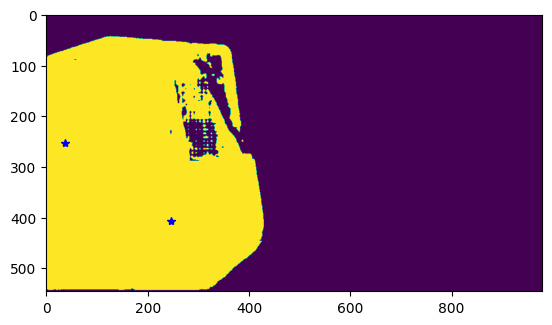

In [6]:
from sam.util import get_best_mask, shrink_mask, sample_points_from_mask
from PIL import Image

views = Viewset(camera_json=CAMERAS_JSON, dataset_path=IMAGE_PATH)

init_views = views.sample(init_view_count, k_means=True)
# init_views = [views.get(23)]
init_prompts = [] # tuples of (view, prompt_coords)

for view in init_views:
    masks, boxes, phrases, logits = langsam.predict(Image.fromarray(view.image), text_prompt)
    # plt.plot(init_prompts[0,:], init_prompts[1,:], 'b*')
    mask, logit = get_best_mask(masks, logits)
    # maybe filter out mask with low logits here
    mask_shrunk = shrink_mask(np.uint8(mask.numpy()), MASK_PADDING)
    
    prompts = sample_points_from_mask(mask_shrunk, prompts_per_view).T
    init_prompts.append((view, prompts))
    plt.imshow(mask)
    plt.plot(prompts[0,:], prompts[1,:], 'b*')
    plt.show()

### Map 2D input points to 3D Gaussians

In [7]:
prompt_gaussians = torch.empty((0, 3))

for view, prompts in init_prompts:

    projection = view.project(pcd_array)

    # scale user points in case image mismatches sizes defined in cameras.json
    user_points = view.scale_from_image(prompts)

    pcd_indices = get_3D_indices(projection.coords, projection.depths, 
                                projection.indices, user_points, EPS, opacities)

    gaussians = pcd_array[pcd_indices, :] 
    prompt_gaussians = torch.vstack((prompt_gaussians, gaussians))

print(prompt_gaussians) 

Point 1: 
	 Depth: 4.66665463641151
	 (x,y) => tensor([1092,  522], dtype=torch.int32)
Point 2: 
	 Depth: 2.1433250555720673
	 (x,y) => tensor([1430,  500], dtype=torch.int32)
Point 1: 
	 Depth: 1.8997229918042233
	 (x,y) => tensor([718, 410], dtype=torch.int32)
Point 2: 
	 Depth: 1.9625445149396614
	 (x,y) => tensor([567, 412], dtype=torch.int32)
Point 1: 
	 Depth: 1.8330675373185352
	 (x,y) => tensor([1805,  507], dtype=torch.int32)
Point 2: 
	 Depth: 2.003046193735801
	 (x,y) => tensor([1873,  305], dtype=torch.int32)
Point 1: 
	 Depth: 1.3108985461965594
	 (x,y) => tensor([488, 811], dtype=torch.int32)
Point 2: 
	 Depth: 1.190447851174914
	 (x,y) => tensor([ 80, 507], dtype=torch.int32)
tensor([[ 0.9270,  0.6191, -0.1928],
        [-1.2218, -0.0959,  0.9825],
        [-2.4804,  0.2535,  0.5675],
        [-2.4460,  0.2254,  0.8402],
        [-2.1168,  0.2365,  1.1238],
        [-2.1161,  0.0115,  0.7230],
        [-1.1027,  0.4679, -0.2465],
        [-1.3026,  0.0285, -0.0671]], dty

***
# 2. Creating Masks from Prompts

Helper function

In [8]:
def predict_mask_from_view(prompt_gaussians, view):
    points, labels = view.project(prompt_gaussians).to_sam_input(view.scale)
    if points.shape[0] == 0:
        # handle cases when none of the prompt gaussians are in view
        return None

    mask_view, scores_view, _ = sam.predict(view.image, points, labels, multimask=True)

    # get mask with the best score
    max_score = 0
    max_ind = 0
    for i, score in enumerate(scores_view):
        if score > max_score:
            max_score = score
            max_ind = i

    return mask_view[max_ind], points

Create Masks from multiple views

Create masks from a subset of all views, based on `view_sampling_rate`. Results are stored in `results`

In [9]:
from tqdm import tqdm

torch.cuda.empty_cache()

views_subset = views.sample(round(view_sampling_rate * views.count))

# results is a list of result sublist each containing [view, mask, prompt_point_pos]
results = []

# track views that do not contain the prompt points
missing_view_indices = []

for view in tqdm(views_subset):
    result = predict_mask_from_view(prompt_gaussians, view)

    if result is not None:
        results.append([view, *result])
    else:
        missing_view_indices.append(view.index)

print("Views containing no visible prompt points:", missing_view_indices)

100%|██████████| 126/126 [02:35<00:00,  1.23s/it]

Views containing no visible prompt points: []


### Optionally save and load serialized results

In [10]:
# save serialized results
import pickle

with open("./results.pkl", "wb") as f:
    pickle.dump(results, f)

In [29]:
import pickle
from matplotlib import pyplot as plt
import numpy as np

# load results
with open("./results_singleview_good.pkl", 'rb') as f:
    results = pickle.load(f)

print(results[0][0]) # view
print(results[0][1]) # mask
print(results[0][2]) # projected prompts

[[False False False ... False False False]
 [False False False ... False False False]
 [False False False ... False False False]
 ...
 [False False False ... False False False]
 [False False False ... False False False]
 [False False False ... False False False]]
[[468. 336.]
 [739. 294.]
 [872. 265.]
 [533. 352.]
 [447. 275.]
 [964. 291.]
 [778. 196.]
 [506. 257.]]


### Visualize all result masks

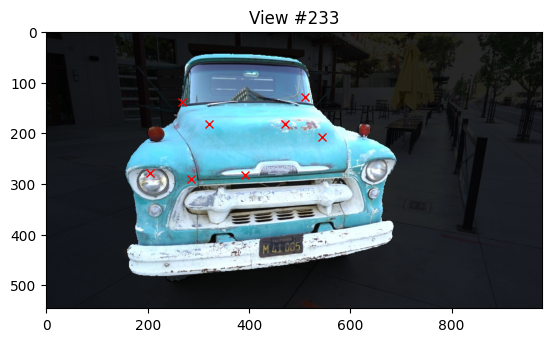

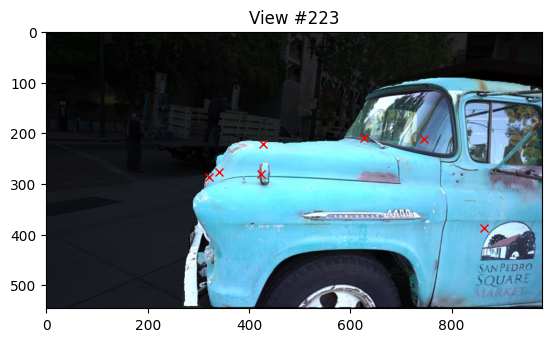

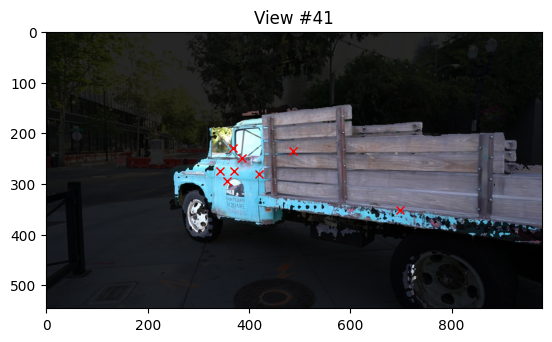

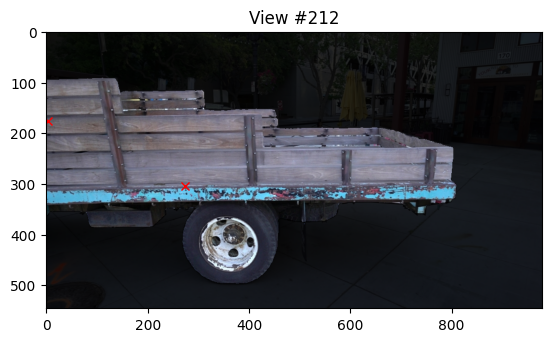

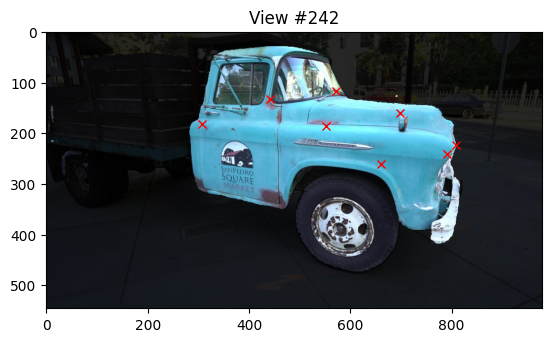

...

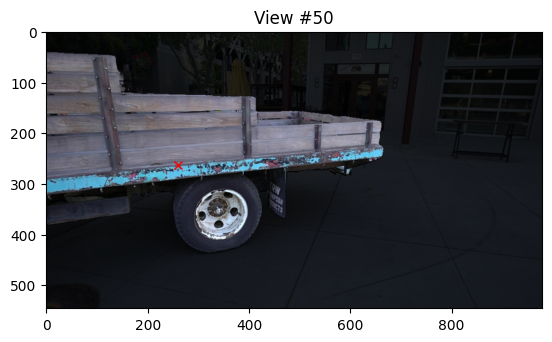

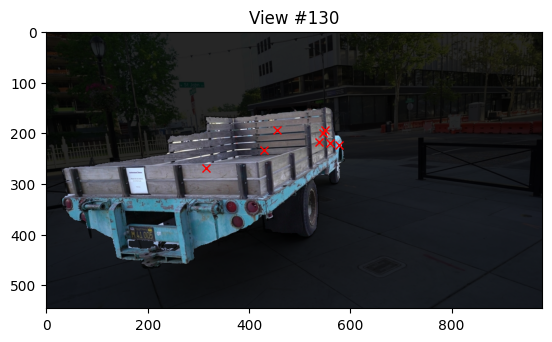

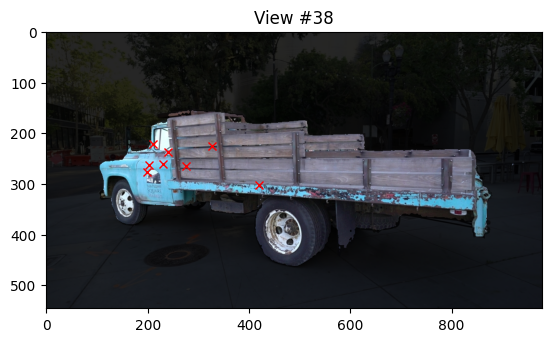

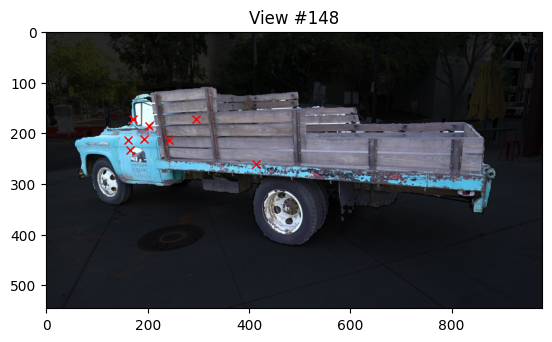

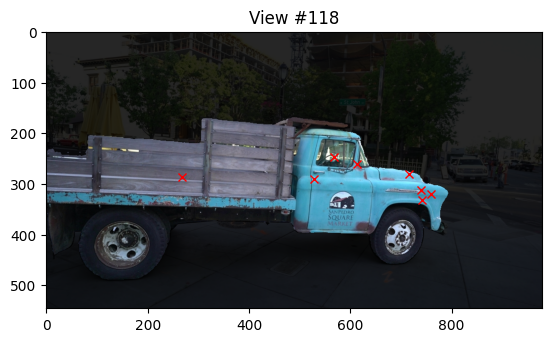

In [12]:
for view, mask, points in results:
    plt.title(f"View #{view.index}")

    # composites mask with original image, showing faint masked areas
    plt.imshow(np.round(np.clip(mask[:,:,np.newaxis], 0.15, 1, dtype=float) * view.image).astype(int)) 
    plt.plot(points[:,0], points[:,1], 'rx')
    plt.show()

# 3. Majority Voting 

In [30]:
from util.voting import make_filter_matrix, majority_voting

### Create L Matrix 

In [31]:
num_views = len(results) 
num_points = pcd_array.shape[0]

L = make_filter_matrix(results, pcd_array, num_views, num_points)  
print(L) 

tensor([[0., 0., 0.,  ..., 0., 0., 1.],
        [1., 0., 1.,  ..., 1., 1., 0.],
        [0., 0., 0.,  ..., 1., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]])


### Perform Majority Voting 

In [32]:
segmented_gaussian_mask = majority_voting(L) 

In [33]:
segmented_pcd_array = pcd_array[segmented_gaussian_mask, :] 

In [34]:
segmented_pcd_array

tensor([[-0.2395, -0.2551,  1.3519],
        [-0.9557,  0.3545, -0.2070],
        [-0.5927,  0.2837, -0.0691],
        ...,
        [-0.3108,  0.2783,  0.4586],
        [-0.3086,  0.2989,  0.4473],
        [-0.2978,  0.3362,  0.2431]], dtype=torch.float64)

### Create new ply for segmented gaussians

In [35]:
from util.segment import create_segmented_ply 

create_segmented_ply(pcd, segmented_pcd_array, segmented_gaussian_mask, 'singleview_good.ply')

# Quantitative Results 

In [44]:
DEST_DIR = '../rendersOrchid' 

from PIL import Image
import numpy as np  
import os 

iou = 0.0 
accuracy = 0.0
count = 0

for filename in os.listdir(os.path.join(DEST_DIR, 'gt')):  

    count += 1 

    gt_file = os.path.join(DEST_DIR, 'gt', filename) 
    rend_file = os.path.join(DEST_DIR, 'renders', filename)

    # Load images
    gt_image = np.asarray(Image.open(gt_file).convert('L'))  # Convert to grayscale
    pred_image = np.asarray(Image.open(rend_file).convert('L'))  # Convert to grayscale   

    # Threshold images to get binary masks, assuming non-black (non-zero) pixels are foreground
    gt_mask = np.array(gt_image) > 0
    pred_mask = np.array(pred_image) > 0

    # Calculate intersection and union
    intersection = np.logical_and(gt_mask, pred_mask)
    union = np.logical_or(gt_mask, pred_mask)

    # Calculate IoU
    iou += intersection.sum() / union.sum()

    # Calculate pixel accuracy
    accuracy += np.mean(gt_mask == pred_mask)  


iou /= count 
accuracy /= count 

print(f'IoU: {iou:.4f}')
print(f'Accuracy: {accuracy:.4f}')

IoU: 0.7604
Accuracy: 0.9571
